# Deep Learning
With Python: TensorFlow, Keras 
    
    AUTHOR: Dr. Roy Jafari 

## Video 2: Model vs. Solver

### In this video:

- What is the difference between a model and a solver?
- Understand toy dataset
- Model a classification problem using a linear model
- Solve using visual try and error
- Solve using data-driven try and error
- solve using Genetic Algorithm
- Solve using Gradient Descent - own code
- Solve using Gradient Descent - TensorFlow
- Compare own code vs TensorFlow
- Video Summary


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

### Understand toy dataset

In [2]:
toy_df = pd.read_csv('simulated_data.csv')
toy_df

,X,Y,label
0,0.661036,4.789633,1
1,-0.163488,3.760396,1
2,4.933172,0.606117,0
3,0.705611,4.977509,1
4,1.457799,4.366863,1
...,...,...,...
199995,1.479293,3.747308,1
199996,4.410008,0.094663,0
199997,2.280923,5.141127,1
199998,1.643009,4.235042,1


<AxesSubplot:xlabel='X', ylabel='Y'>

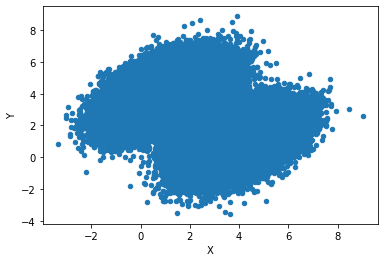

In [3]:
toy_df.plot.scatter(x='X',y='Y')

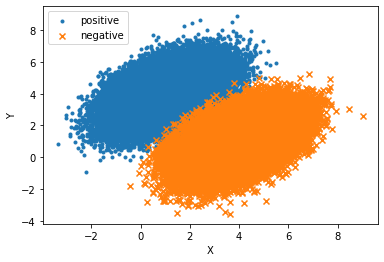

In [4]:
BM = toy_df.label == 1
vis_df = toy_df[BM]
plt.scatter(vis_df.X, vis_df.Y, marker='.', label = 'positive')

BM = toy_df.label == 0
vis_df = toy_df[BM]
plt.scatter(vis_df.X, vis_df.Y, marker='x', label = 'negative')

plt.xlabel('X')
plt.ylabel('Y')
plt.legend(loc=2)
plt.show()

## Model a classification problem using a linear model

$$ labelScore = X*w1 + Y*w2 + b$$

$$
label
= 
\begin{cases}
0 \text{ if }  labelScore < 0.5\\
1 \text{ if }  labelScore \geqslant 0.5
\end{cases}
$$

In [5]:
def model(X,Y,params):
    w1 = params[0]
    w2 = params[1]
    b = params[2]
    return X*w1 + Y*w2 + b

In [6]:
x = 4
y = 0

params = (0.5, -1.5, 0.5)

model(x,y,params)

2.5

### Seeing the linear model

$$ 0.5 = X*w1 + Y*w2 + b$$

$$ - Y*w2 = X*w1  + b - 0.5 $$

$$ Y = X*\frac{w1}{-w2}  + \frac{b - 0.5}{-w2}  $$

$$ Y = - X*\frac{w1}{w2}  + \frac{0.5 - b}{w2}  $$

In [7]:
def model_line(X,params):
    w1 = params[0]
    w2 = params[1]
    b = params[2]
    
    return -X*(w1/w2) + (0.5-b)/(w2)

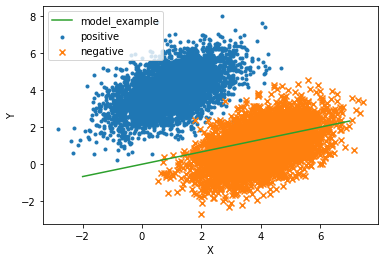

In [8]:
BM = toy_df.label == 1
vis_df = toy_df[BM].sample(5000)
plt.scatter(vis_df.X, vis_df.Y, marker='.', label = 'positive')

BM = toy_df.label == 0
vis_df = toy_df[BM].sample(5000)
plt.scatter(vis_df.X, vis_df.Y, marker='x', label = 'negative')

x = np.arange(-2,8)
y = model_line(x,params)
plt.plot(x,y,label = 'model_example',color='C2')


plt.xlabel('X')
plt.ylabel('Y')
plt.legend(loc=2)
plt.show()

## Solver 1 - Try and error - Visual

In [9]:
def test_params(params):
    
    BM = toy_df.label == 1
    vis_df = toy_df[BM].sample(5000,random_state=3)
    plt.scatter(vis_df.X, vis_df.Y, marker='.', label = 'positive')

    BM = toy_df.label == 0
    vis_df = toy_df[BM].sample(5000,random_state=3)
    plt.scatter(vis_df.X, vis_df.Y, marker='x', label = 'negative')

    x_data = np.arange(-2,8)
    y_data = model_line(x_data, params)
    plt.plot(x_data,y_data,label = 'model_example',color='C2')
    
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.title(f'{params[0]:.2f} | {params[1]:.2f} | {params[2]:.2f} ')
    plt.legend(loc=2)
    plt.show()

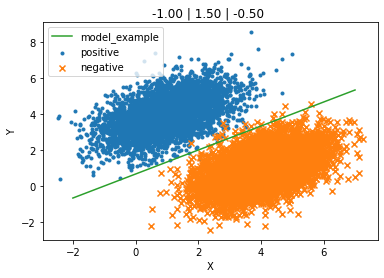

In [17]:
params = (-1,1.5,-0.5)
test_params(params)

In [18]:
w1_options = [i for i in range(-5,6) if i!=0]
print(w1_options)

w2_options = [i for i in range(-5,6) if i!=0]
print(w2_options)

b_options = [i for i in range(-5,6) if i!=0]
print(b_options)

[-5, -4, -3, -2, -1, 1, 2, 3, 4, 5]
[-5, -4, -3, -2, -1, 1, 2, 3, 4, 5]
[-5, -4, -3, -2, -1, 1, 2, 3, 4, 5]


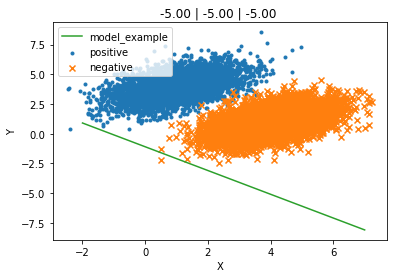

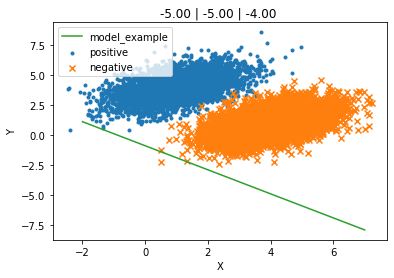

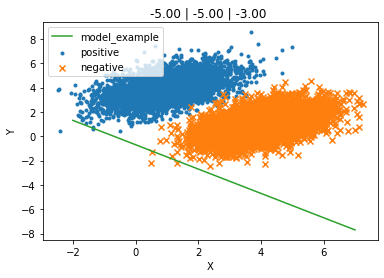

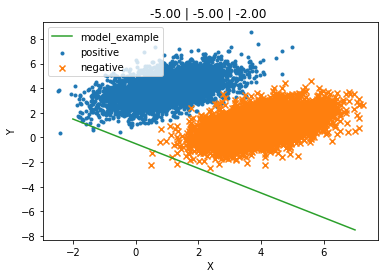

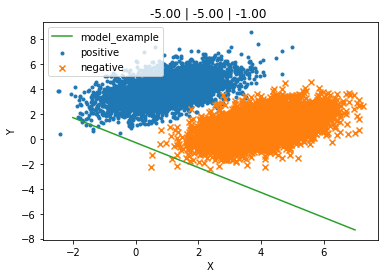

...

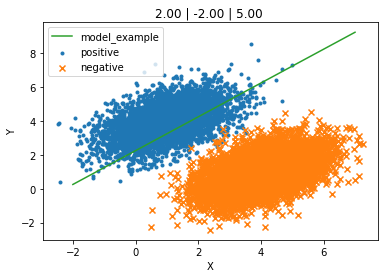

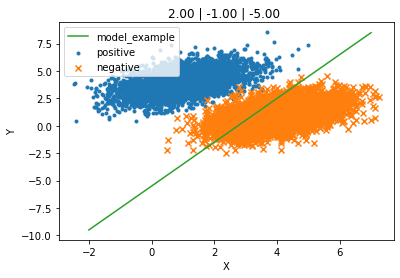

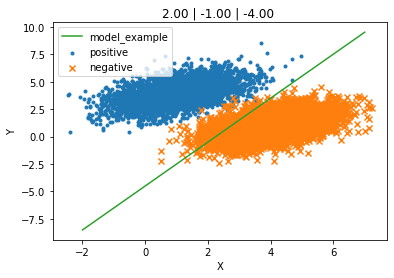

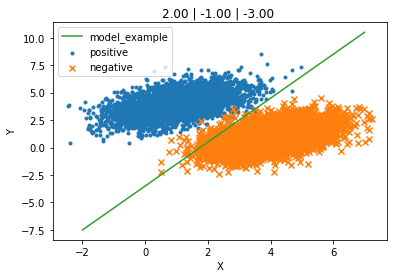

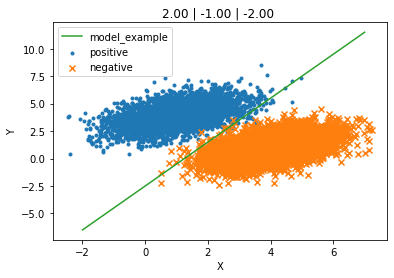

KeyboardInterrupt: 

In [19]:
import itertools
for w1,w2,b in itertools.product(w1_options,w2_options,b_options):
    params = (w1, w2, b)
    test_params(params)

# Solution Found
w1 = -5, w2 = 4, b=2

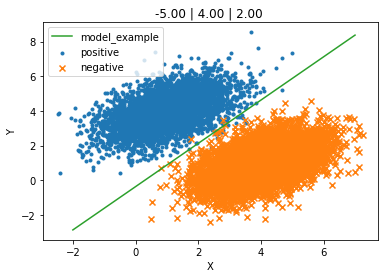

In [20]:
Sol_try_error = (-5,4, 2)
test_params(Sol_try_error)

In [21]:
x,y= 2,6
model(x,y,Sol_try_error)

16

# Solver 2 - Try and Error - Loss function

# Define Loss


In [22]:
def loss_function(y_actual,y_predict):
    y_predict = np.where(y_predict>=0.5,1,y_predict)
    y_predict = np.where(y_predict<0.5,0,y_predict)
    return np.mean((y_predict-y_actual)**2) 

In [23]:
y_predict = model(toy_df.X, toy_df.Y, Sol_try_error)
y_predict

0         17.853352
1         17.859025
2        -20.241395
3         18.381977
4         12.178457
            ...    
199995     9.592767
199996   -19.671392
199997    11.159893
199998    10.725122
199999    17.224735
Length: 200000, dtype: float64

In [24]:
loss_function(toy_df.label,y_predict)

0.00209

In [25]:
import itertools

Sol_try_error_loss = None
best_sol = np.inf
for w1,w2,b in itertools.product(w1_options,w2_options,b_options):
    params = (w1, w2, b)
    
    y_predict = model(toy_df.X.values, toy_df.Y.values,params)
    loss = loss_function(toy_df.label,y_predict)
    
    if(loss<best_sol):
        best_sol = loss
        Sol_try_error_loss = params
        print(f'a new solution was found: loss = {best_sol}, sol: {Sol_try_error_loss}')
    

a new solution was found: loss = 0.50002, sol: (-5, -5, -5)
a new solution was found: loss = 0.49999, sol: (-5, -5, -4)
a new solution was found: loss = 0.499975, sol: (-5, -5, -2)
a new solution was found: loss = 0.4998, sol: (-5, -5, -1)
a new solution was found: loss = 0.499725, sol: (-5, -5, 1)
a new solution was found: loss = 0.49971, sol: (-5, -5, 3)
a new solution was found: loss = 0.49964, sol: (-5, -4, -3)
a new solution was found: loss = 0.499365, sol: (-5, -4, -2)
a new solution was found: loss = 0.49911, sol: (-5, -4, -1)
a new solution was found: loss = 0.498365, sol: (-5, -4, 1)
a new solution was found: loss = 0.497655, sol: (-5, -4, 2)
a new solution was found: loss = 0.49696, sol: (-5, -4, 3)
a new solution was found: loss = 0.49572, sol: (-5, -4, 4)
a new solution was found: loss = 0.494015, sol: (-5, -4, 5)
a new solution was found: loss = 0.493805, sol: (-5, -3, 2)
a new solution was found: loss = 0.49096, sol: (-5, -3, 3)
a new solution was found: loss = 0.4877, so

In [26]:
Sol_try_error_loss

(-5, 5, 1)

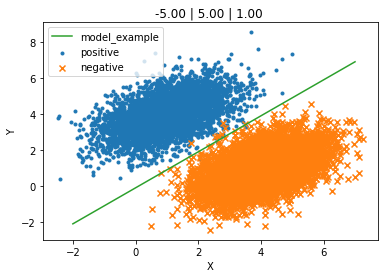

In [27]:
test_params(Sol_try_error_loss)

# Slover 3 - Genetic Algorithm

In [29]:
def loss_ga(X):
    params = (X[0],X[1],X[2])
    y_predict = model(toy_df.X, toy_df.Y,params)
    y_predict = np.where(y_predict>0.5,1,y_predict)
    y_predict = np.where(y_predict<0.5,0,y_predict)
    
    y_actual = toy_df.label
    return np.mean((y_predict-y_actual)**2) 

 The best solution found:                                                                           
 [-5.05612437  4.88071902  0.96966161]

 Objective function:
 0.0012


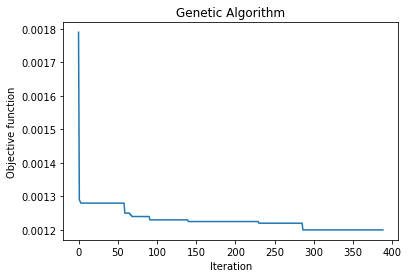

In [30]:
%%time

from geneticalgorithm import geneticalgorithm as ga

varbound=np.array([[-10,10]]*3)

algorithm_param = {'max_num_iteration': 500,
                   'population_size':100,
                   'mutation_probability':0.1,
                   'elit_ratio': 0.01,
                   'crossover_probability': 0.5,
                   'parents_portion': 0.3,
                   'crossover_type':'uniform',
                   'max_iteration_without_improv':100}

ga_solver=ga(function=loss_ga,
             dimension=3,
             variable_type='real',
             variable_boundaries=varbound,
             algorithm_parameters=algorithm_param)

ga_solver.run()

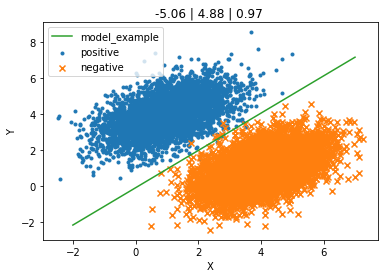

In [31]:
Sol_ga_loss = tuple(ga_solver.best_variable)
test_params(Sol_ga_loss)

In [32]:
y_predict = model(toy_df.X, toy_df.Y,Sol_ga_loss)
print(f'GA loss: {loss_function(toy_df.label,y_predict)}')

y_predict = model(toy_df.X, toy_df.Y,Sol_try_error_loss)
print(f'try&error loss: {loss_function(toy_df.label,y_predict)}')


GA loss: 0.0012
try&error loss: 0.00128


# Solve 4 - Gradient Decent

In [33]:
def loss_gd(X):
    params = (X[0],X[1],X[2])
    y_predict = model(toy_df.X, toy_df.Y,params)
    
    y_actual = toy_df.label
    return np.mean((y_predict-y_actual)**2) 

In [34]:
initial_sol = [0.01,0.01,0.01]
loss_gd(initial_sol)

0.4439406746147211

In [35]:
def extract_slopes(X):
    eps = 0.000001
    
    gradients = []
    
    for i in range(len(X)):
        
        params = np.array((X[0],X[1],X[2]))
        params[i] = params[i] - eps
        n_params = params
        
        params = np.array((X[0],X[1],X[2]))
        params[i] = params[i] + eps
        p_params = params

        n_loss = loss_gd(n_params)
        p_loss = loss_gd(p_params)
        
        gradients.append((p_loss-n_loss)/(p_params[i]-n_params[i]))
    
    
    return(np.array(gradients))

In [36]:
extract_slopes(initial_sol)

array([-0.66911223, -3.66728374, -0.88009781])

In [37]:
def update_params(X):
    learning_rate = 0.05
    
    gradients = extract_slopes(X)
    
    return X -  gradients*learning_rate

In [38]:
print(initial_sol)
update_params(initial_sol)

[0.01, 0.01, 0.01]


array([0.04345561, 0.19336419, 0.05400489])

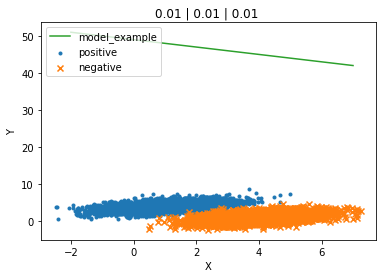

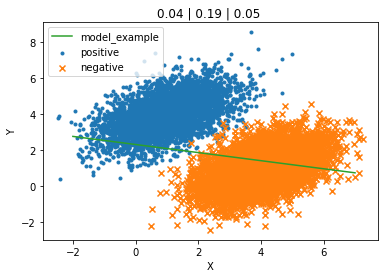

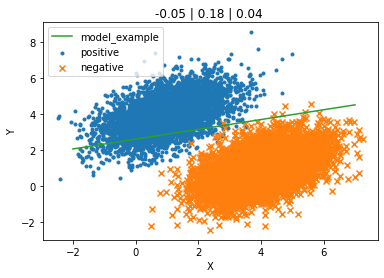

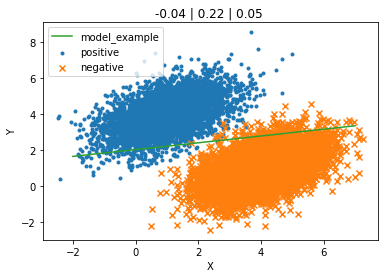

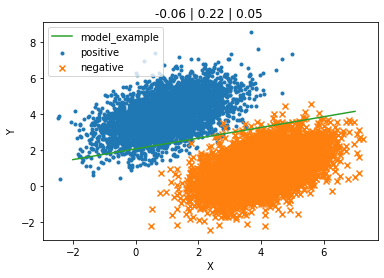

...

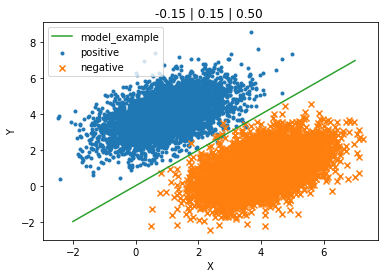

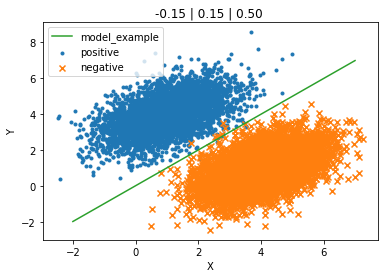

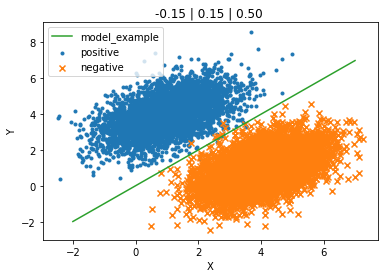

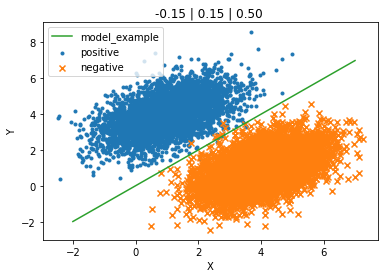

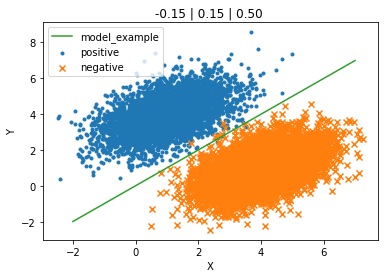

In [39]:
initial_sol = [0.01,0.01,0.01]
test_params(initial_sol)

current_sol = initial_sol
for i in range(500):
    
    current_sol = update_params(current_sol)
    test_params(tuple(current_sol))

In [40]:
%%time
initial_sol = [0.01,0.01,0.01]

current_sol = initial_sol
for i in range(500):
    
    current_sol = update_params(current_sol)
    
Sol_gd = current_sol

Wall time: 16.6 s


In [41]:
y_predict = model(toy_df.X, toy_df.Y,Sol_gd)
print(loss_function(toy_df.label,y_predict))
print(loss_gd(Sol_gd))

0.00125
0.025002040464185138


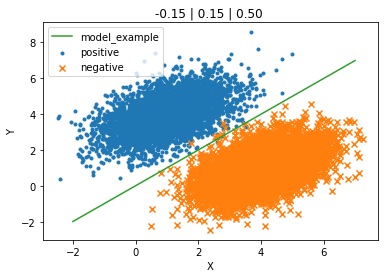

In [42]:
test_params(tuple(Sol_gd))

# Solver 5 - Gradient Decent - TensorFlow

In [43]:
import tensorflow as tf

In [44]:
params_gd = tf.Variable(initial_value = np.array([[0.01],[0.01],[0.01]]))
params_gd

<tf.Variable 'Variable:0' shape=(3, 1) dtype=float64, numpy=
array([[0.01],
       [0.01],
       [0.01]])>

In [46]:
def model_tf(df):
    
    part1 = tf.math.multiply(toy_df.X,params_gd[0])
    part2 = tf.math.multiply(toy_df.Y,params_gd[1])
    
    output = tf.math.add(part1,part2)
        
    return tf.math.add(output,params_gd[2])

In [47]:
model_tf(toy_df[['X','Y']])

<tf.Tensor: shape=(200000,), dtype=float64, numpy=
array([0.06450669, 0.04596909, 0.06539289, ..., 0.0842205 , 0.06878051,
       0.04888873])>

In [48]:
def loss_gd_tf(df):
    y_predict = model_tf(df[['X','Y']])
    
    y_actual = df.label
    return tf.reduce_mean(tf.square(y_predict-y_actual)) 

In [51]:
with tf.GradientTape() as tape:
    loss_value=loss_gd_tf(toy_df)
gs = tape.gradient(loss_value,params_gd)

In [52]:
gs

<tf.Tensor: shape=(3, 1), dtype=float64, numpy=
array([[-0.66911223],
       [-3.66728375],
       [-0.88009782]])>

In [53]:
def update_params_tf():
    learning_rate = 0.05
    
    with tf.GradientTape() as tape:
        loss_value=loss_gd_tf(toy_df)
    
    gradients = tape.gradient(loss_value,params_gd)
    
    params_gd.assign_sub(gradients*learning_rate)
    
    return None

In [54]:
for i in range(500):
    update_params_tf()
    
params_gd

<tf.Variable 'Variable:0' shape=(3, 1) dtype=float64, numpy=
array([[-0.14943811],
       [ 0.1504447 ],
       [ 0.49769588]])>

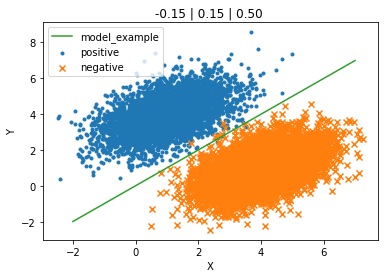

In [55]:
test_params(np.array(params_gd)[:,0])

# Compare Gradient Decent Extract slopes vs. tensorflow tape

In [56]:
%%time
initial_sol = [0.01,0.01,0.01]

current_sol = initial_sol
for i in range(500):
    
    current_sol = update_params(current_sol)
    
Sol_gd = current_sol
Sol_gd

Wall time: 16.4 s


array([-0.14943811,  0.1504447 ,  0.49769588])

In [57]:
%%time
params_gd = tf.Variable(initial_value = np.array([[0.01],[0.01],[0.01]]))
for i in range(500):
    update_params_tf()
    
params_gd

Wall time: 13.2 s


<tf.Variable 'Variable:0' shape=(3, 1) dtype=float64, numpy=
array([[-0.14943811],
       [ 0.1504447 ],
       [ 0.49769588]])>

# Video Summary

- What is the difference between a model and a solver?
- Modeled a classificaiton problem using a linear model
- Solved with Try&error, Genetic Algorithm, Gradient Descent
- Learned about TensorFlow most important contribution
